Mask-RCCN CLIMB



In [ ]:
!unzip /content/climb.v1i.coco-segmentation.zip -d /content/

Archive:  /content/climb.v1i.coco-segmentation.zip
 extracting: /content/README.dataset.txt  
 extracting: /content/README.roboflow.txt  
   creating: /content/test/
 extracting: /content/test/E8A6DF27-98C0-4EB5-8AF1-05416503C4EB_frame_0_jpg.rf.ad907111771051e0e570628a7535186f.jpg  
 extracting: /content/test/E8A6DF27-98C0-4EB5-8AF1-05416503C4EB_frame_5_jpg.rf.1922cc53655c36b8841a7ac6c409b02d.jpg  
 extracting: /content/test/IMG_6360_frame_13_jpg.rf.f199cf5b201267da2dba8aea57ba9f35.jpg  
 extracting: /content/test/IMG_6919_frame_24_jpg.rf.5df7dac28763bf8d1831da933047369d.jpg  
 extracting: /content/test/IMG_6919_frame_51_jpg.rf.6a14def49fa8472e5bfe52df7381a148.jpg  
 extracting: /content/test/_annotations.coco.json  
   creating: /content/train/
 extracting: /content/train/E8A6DF27-98C0-4EB5-8AF1-05416503C4EB_frame_3_jpg.rf.9a850e35ebdbe0596629d1b2567356de.jpg  
 extracting: /content/train/IMG_5089-2_frame_2_jpg.rf.d46293bf225aca8d3b4ddaaa2a57e33a.jpg  
 extracting: /content/train/IMG_

In [ ]:
!nvidia-smi

Mon Jun  5 00:41:33 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-SXM2...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   34C    P0    25W / 300W |      0MiB / 16384MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## Install Detectron2


In [ ]:
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-46qiax_t
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-46qiax_t
  Resolved https://github.com/facebookresearch/detectron2.git to commit dd2db71b0f8d855b71cac655186cbddca1bfda93
  Preparing metadata (setup.py) ... done


Now is a good time to confirm that we have the right versions of the libraries at our disposal.

In [ ]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:33:58_PDT_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0
torch:  2.0 ; cuda:  cu118
detectron2: 0.6


In [ ]:
# COMMON LIBRARIES
import os
import cv2

from datetime import datetime
from google.colab.patches import cv2_imshow

# DATA SET PREPARATION AND LOADING
from detectron2.data.datasets import register_coco_instances
from detectron2.data import DatasetCatalog, MetadataCatalog

# VISUALIZATION
from detectron2.utils.visualizer import Visualizer
from detectron2.utils.visualizer import ColorMode

# CONFIGURATION
from detectron2 import model_zoo
from detectron2.config import get_cfg

# EVALUATION
from detectron2.engine import DefaultPredictor

# TRAINING
from detectron2.engine import DefaultTrainer

## Run a Pre-trained Detectron2 Model

In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)
outputs = predictor(image)

/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


In [ ]:
# DATA_SET_NAME = dataset.name.replace(" ", "-")
DATA_SET_NAME = 'climb'
ANNOTATIONS_FILE_NAME = "_annotations.coco.json"

In [ ]:
print(DATA_SET_NAME)

climb


In [ ]:
if 'climb-valid' in DatasetCatalog.list():
    DatasetCatalog.remove('climb-valid')

In [ ]:

location = '/content/climb-1'

In [ ]:
# TRAIN SET
TRAIN_DATA_SET_NAME = f"{DATA_SET_NAME}-train"
TRAIN_DATA_SET_IMAGES_DIR_PATH = os.path.join(location, "train")
TRAIN_DATA_SET_ANN_FILE_PATH = os.path.join(location, "train", ANNOTATIONS_FILE_NAME)

register_coco_instances(
    name=TRAIN_DATA_SET_NAME, 
    metadata={}, 
    json_file=TRAIN_DATA_SET_ANN_FILE_PATH, 
    image_root=TRAIN_DATA_SET_IMAGES_DIR_PATH
)

# TEST SET
TEST_DATA_SET_NAME = f"{DATA_SET_NAME}-test"
TEST_DATA_SET_IMAGES_DIR_PATH = os.path.join(location, "test")
TEST_DATA_SET_ANN_FILE_PATH = os.path.join(location, "test", ANNOTATIONS_FILE_NAME)

register_coco_instances(
    name=TEST_DATA_SET_NAME, 
    metadata={}, 
    json_file=TEST_DATA_SET_ANN_FILE_PATH, 
    image_root=TEST_DATA_SET_IMAGES_DIR_PATH
)

# VALID SET
VALID_DATA_SET_NAME = f"{DATA_SET_NAME}-valid"
VALID_DATA_SET_IMAGES_DIR_PATH = os.path.join(location, "valid")
VALID_DATA_SET_ANN_FILE_PATH = os.path.join(location, "valid", ANNOTATIONS_FILE_NAME)

register_coco_instances(
    name=VALID_DATA_SET_NAME, 
    metadata={}, 
    json_file=VALID_DATA_SET_ANN_FILE_PATH, 
    image_root=VALID_DATA_SET_IMAGES_DIR_PATH
)

### Visualize

Let's take a look at single entry from out train dataset.

Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.



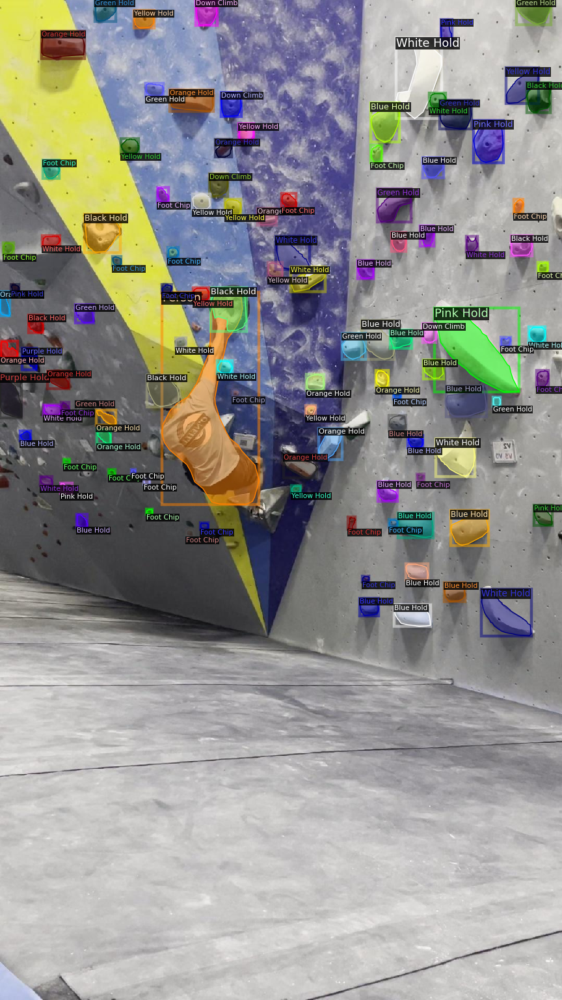

In [ ]:
metadata = MetadataCatalog.get(TRAIN_DATA_SET_NAME)
dataset_train = DatasetCatalog.get(TRAIN_DATA_SET_NAME)

dataset_entry = dataset_train[0]
image = cv2.imread(dataset_entry["file_name"])

visualizer = Visualizer(
    image[:, :, ::-1],
    metadata=metadata, 
    scale=0.8, 
    instance_mode=ColorMode.IMAGE_BW
)

out = visualizer.draw_dataset_dict(dataset_entry)
cv2_imshow(out.get_image()[:, :, ::-1])

## Training on climb dataset


### Configuration

In [ ]:
# HYPERPARAMETERS
ARCHITECTURE = "mask_rcnn_R_101_FPN_3x"
CONFIG_FILE_PATH = f"COCO-InstanceSegmentation/{ARCHITECTURE}.yaml"
MAX_ITER = 2000
EVAL_PERIOD = 200
BASE_LR = 0.001
NUM_CLASSES = 14

# OUTPUT DIR
OUTPUT_DIR_PATH = os.path.join(
    DATA_SET_NAME, 
    ARCHITECTURE, 
    datetime.now().strftime('%Y-%m-%d-%H-%M-%S')
)

os.makedirs(OUTPUT_DIR_PATH, exist_ok=True)

In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file(CONFIG_FILE_PATH))
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(CONFIG_FILE_PATH)
cfg.DATASETS.TRAIN = (TRAIN_DATA_SET_NAME,)
cfg.DATASETS.TEST = (TEST_DATA_SET_NAME,)
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.TEST.EVAL_PERIOD = EVAL_PERIOD
cfg.DATALOADER.NUM_WORKERS = 2
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.INPUT.MASK_FORMAT='bitmask'
cfg.SOLVER.BASE_LR = BASE_LR
cfg.SOLVER.MAX_ITER = MAX_ITER
cfg.MODEL.ROI_HEADS.NUM_CLASSES = NUM_CLASSES
cfg.OUTPUT_DIR = OUTPUT_DIR_PATH

### Training

In [ ]:
import os
os.environ['CUDA_LAUNCH_BLOCKING'] = "1"
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[06/05 01:11:33 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[06/05 01:11:34 d2.engine.train_loop]: Starting training from iteration 0
[06/05 01:11:46 d2.utils.events]:  eta: 0:16:49  iter: 19  total_loss: 7.329  loss_cls: 2.604  loss_box_reg: 0.5633  loss_mask: 0.6926  loss_rpn_cls: 3.116  loss_rpn_loc: 0.3414    time: 0.5362  last_time: 0.3808  data_time: 0.2694  last_data_time: 0.0661   lr: 1.9981e-05  max_mem: 4059M
[06/05 01:12:00 d2.utils.events]:  eta: 0:16:54  iter: 39  total_loss: 3.978  loss_cls: 2.36  loss_box_reg: 0.617  loss_mask: 0.687  loss_rpn_cls: 0.1287  loss_rpn_loc: 0.2299    time: 0.5283  last_time: 0.6326  data_time: 0.2012  last_data_time: 0.3076   lr: 3.9961e-05  max_mem: 4246M
[06/05 01:12:11 d2.utils.events]:  eta: 0:17:24  iter: 59  total_loss: 3.379  loss_cls: 1.77  loss_box_reg: 0.5983  loss_mask: 0.673  loss_rpn_cls: 0.1038  loss_rpn_loc: 0.209    time: 0.5402  last_time: 0.5779  data_time: 0.2513  last_data_time: 0.2607   lr: 5.9941e-05  max_mem: 4246M
[06/05 01:12:22 d2.utils.events]:  eta: 0:17:16  iter: 79  tota

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir $OUTPUT_DIR_PATH

<IPython.core.display.Javascript object>

### Evaluation

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7
predictor = DefaultPredictor(cfg)

[06/05 01:30:36 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from climb/mask_rcnn_R_101_FPN_3x/2023-06-05-01-11-18/model_final.pth ...


WARNING [06/05 01:34:07 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/05 01:34:07 d2.data.datasets.coco]: Loaded 10 images in COCO format from /content/climb-1/valid/_annotations.coco.json
{'instances': Instances(num_instances=80, image_height=1920, image_width=1080, fields=[pred_boxes: Boxes(tensor([[4.5208e+02, 5.7314e+02, 5.2755e+02, 6.2025e+02],
        [8.2751e+01, 1.1775e+03, 1.3086e+02, 1.2304e+03],
        [1.7941e+02, 1.0030e+03, 2.5531e+02, 1.0958e+03],
        [2.2470e+00, 1.8150e+03, 7.1430e+01, 1.9116e+03],
        [2.6676e+02, 8.7616e+02, 3.3222e+02, 9.3083e+02],
        [6.3303e+02, 1.4432e+03, 6.9927e+02, 1.4912e+03],
        [2.6100e+01, 6.6829e+02, 6.0068e+01, 6.9353e+02],
        [3.0020e+02, 5.0793e+02, 3.2295e+02, 5.2646e+02],
        [5.1337e+02, 5.0101e+02, 5.7303e+02, 5.3557e+02],
        [3.8963e+02, 1.2578e+03, 5.7032e+02, 1.3574e+03],
        [3.2051e+02, 6.9150e+02, 4.0543e+02, 7.4341e+0

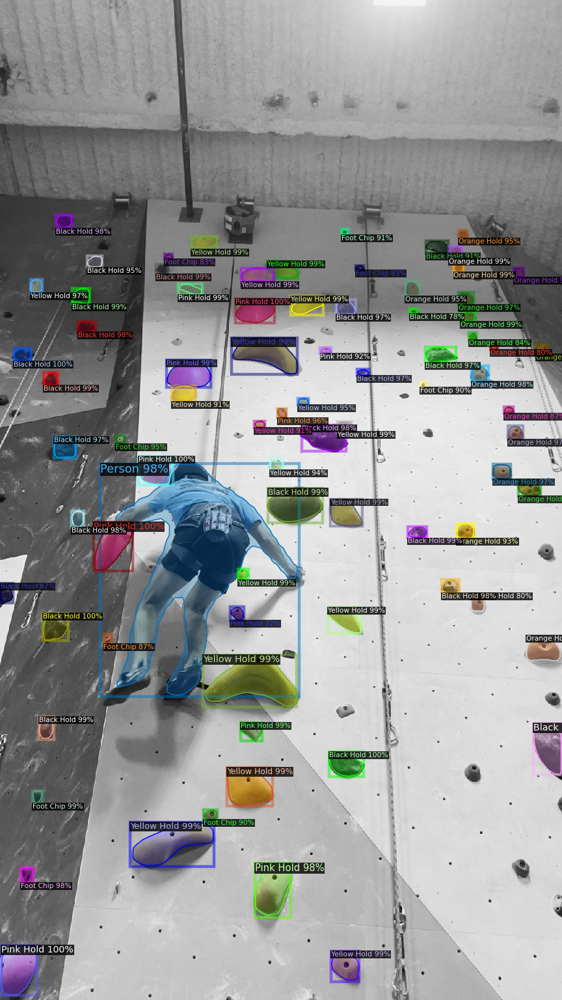

{'instances': Instances(num_instances=56, image_height=1072, image_width=640, fields=[pred_boxes: Boxes(tensor([[255.7987, 675.0767, 290.0106, 714.6061],
        [287.4443, 590.1935, 326.1051, 626.1547],
        [426.1134, 165.9623, 521.9036, 259.0442],
        [203.8073, 491.0998, 260.3984, 535.3119],
        [155.9599, 666.9510, 175.0062, 683.9830],
        [375.1317, 268.5361, 420.1655, 310.5902],
        [302.4595, 181.9175, 335.4357, 218.7779],
        [  0.0000, 391.1071,  21.1657, 420.5744],
        [275.4745, 512.0717, 296.3287, 566.6842],
        [ 70.1360, 630.1392, 111.3946, 665.8394],
        [116.2057, 446.2256, 137.4517, 497.5632],
        [132.1891, 118.9465, 169.6238, 138.4797],
        [170.4599, 146.0568, 217.5318, 184.6490],
        [227.8413, 302.4225, 295.7756, 363.3514],
        [376.5856, 537.1722, 394.8691, 552.3776],
        [194.3022, 421.8585, 232.0548, 457.6356],
        [204.5785, 541.1368, 236.5521, 585.2066],
        [248.0073,   8.3138, 466.2523, 322.322

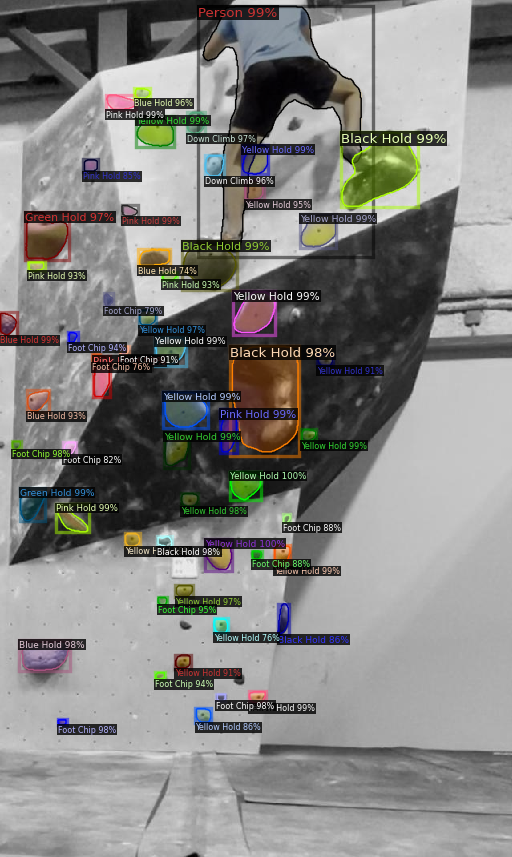

{'instances': Instances(num_instances=61, image_height=1920, image_width=1080, fields=[pred_boxes: Boxes(tensor([[ 389.5660, 1411.8699,  405.9835, 1426.9316],
        [   2.2723,  381.2522,   39.7837,  428.1323],
        [ 804.5591, 1104.6132,  959.7643, 1161.9932],
        [ 678.2840,  425.9304,  731.6166,  489.3988],
        [ 765.7045, 1042.4827,  825.0243, 1100.5302],
        [ 740.4519,  570.6464,  807.0127,  631.7486],
        [ 837.4673,  839.2464,  891.5999,  905.9271],
        [ 746.5427,  415.3995,  808.2861,  484.0700],
        [ 566.0781,  310.8135,  632.4936,  384.5830],
        [ 867.4196,  956.5823,  923.8375,  988.0049],
        [ 897.8931,  628.0539,  960.9462,  699.2568],
        [ 692.3674,  916.7289,  751.2936,  971.0546],
        [ 479.1711,  558.0853,  542.3231,  632.7601],
        [ 651.8995,  359.4727,  764.5530,  397.7933],
        [ 984.9579,  237.3761, 1049.9189,  299.9061],
        [ 887.0363,  703.3387,  968.3822,  762.2471],
        [ 377.0889,  960.5634, 

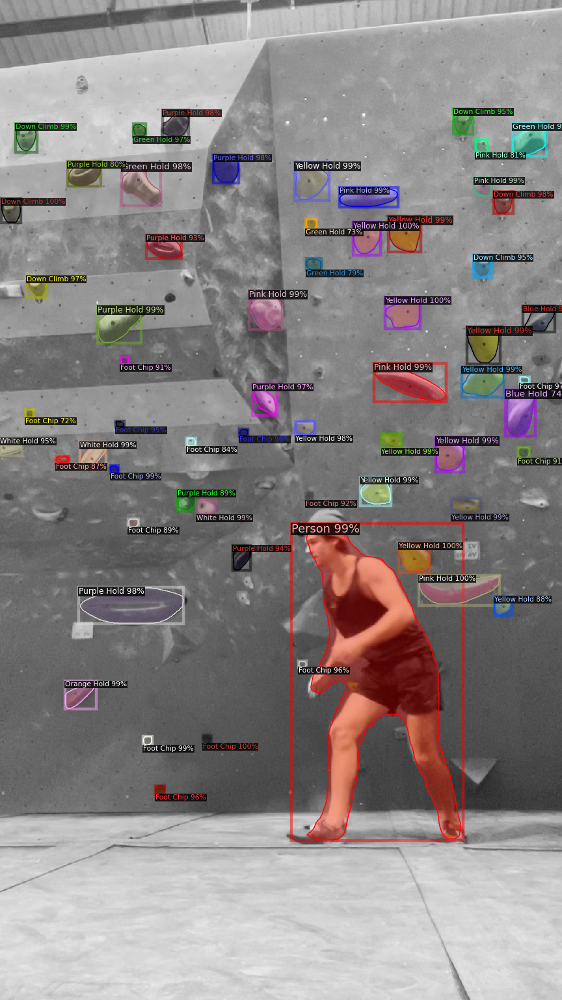

{'instances': Instances(num_instances=78, image_height=1920, image_width=1080, fields=[pred_boxes: Boxes(tensor([[ 708.2112,  859.8041,  737.9516,  895.0719],
        [ 649.5361,  675.1193,  705.3698,  720.7726],
        [  17.9092,  894.8138,   92.0236,  984.2627],
        [ 821.3039,  445.1229,  864.5858,  486.5902],
        [ 868.2620,  333.5864,  966.4868,  428.9164],
        [ 611.7682,  325.9165,  658.2038,  364.5105],
        [ 737.3810,  544.3083,  787.0571,  597.3828],
        [ 210.1785,  448.5683,  245.5272,  480.4311],
        [ 340.1906,  566.6747,  376.9720,  592.2576],
        [ 166.5370,  789.5475,  202.0737,  810.0991],
        [ 671.7603,  486.3276,  738.7566,  542.9266],
        [ 695.2604,  371.6836,  720.3181,  401.4794],
        [ 313.3538,  508.8651,  381.6546,  545.0204],
        [ 197.7814,  859.9245,  230.6710,  884.5437],
        [ 473.6066,  456.6772,  526.8057,  513.8541],
        [ 329.3415,  659.0432,  397.6346,  693.8043],
        [ 134.3498,  785.0742, 

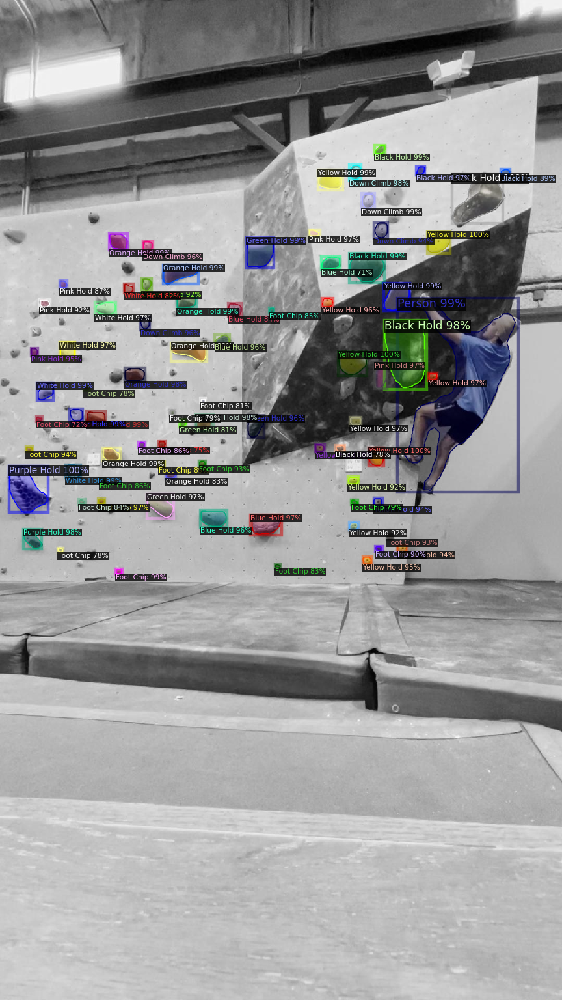

{'instances': Instances(num_instances=63, image_height=1920, image_width=1080, fields=[pred_boxes: Boxes(tensor([[5.3012e+02, 7.6135e+02, 6.8017e+02, 9.0678e+02],
        [3.8745e+02, 2.3679e+02, 5.5328e+02, 4.1794e+02],
        [9.5181e-01, 9.0518e+02, 4.7401e+01, 9.7025e+02],
        [2.6255e+02, 6.6571e+02, 3.0194e+02, 7.2679e+02],
        [5.4875e+02, 2.3091e+02, 6.2210e+02, 3.0575e+02],
        [8.3379e+02, 7.4848e+02, 8.9768e+02, 7.8162e+02],
        [1.8347e+02, 8.7852e+02, 2.6137e+02, 9.3395e+02],
        [5.7550e+02, 1.2736e+03, 6.4314e+02, 1.3113e+03],
        [6.7501e+02, 1.2839e+03, 6.9248e+02, 1.3009e+03],
        [5.8733e+01, 2.6453e+01, 1.3832e+02, 1.3202e+02],
        [6.5350e+02, 3.5472e+02, 6.9610e+02, 4.2640e+02],
        [3.4092e+02, 4.3276e+01, 4.0169e+02, 9.1363e+01],
        [7.1102e+02, 1.0556e+03, 7.6321e+02, 1.1097e+03],
        [8.0253e+02, 3.5606e+02, 9.1917e+02, 4.7112e+02],
        [5.2665e+02, 1.3596e+03, 5.4392e+02, 1.3775e+03],
        [2.6686e+02, 5.12

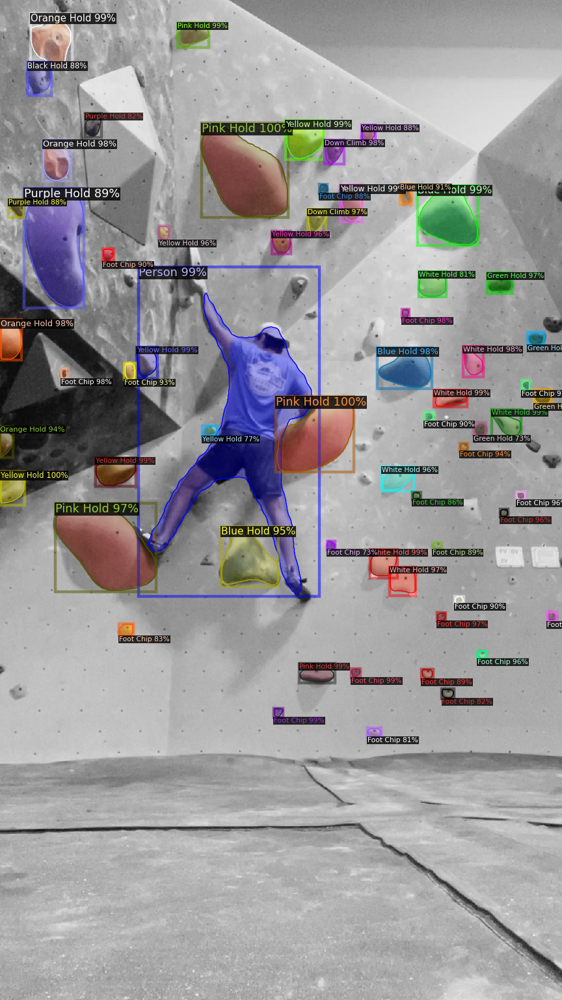

{'instances': Instances(num_instances=48, image_height=1232, image_width=672, fields=[pred_boxes: Boxes(tensor([[107.7445, 437.3126, 142.7738, 495.4491],
        [ 36.4198, 593.5558,  62.2587, 633.5673],
        [ 49.8790, 662.0291,  84.1296, 765.1790],
        [377.9472, 692.1757, 439.9746, 750.6212],
        [520.1972, 529.3425, 542.2078, 554.2026],
        [179.5288, 439.4242, 236.7410, 514.1887],
        [560.5160, 653.2779, 581.1955, 680.4883],
        [364.9291, 825.7366, 386.9381, 846.4159],
        [291.8394, 241.7174, 302.0358, 253.5908],
        [573.5474, 725.6015, 588.5734, 750.6147],
        [513.4291, 246.3657, 619.3474, 614.3360],
        [332.0440, 569.4676, 377.6624, 597.1092],
        [209.4795, 877.0179, 252.4389, 906.2959],
        [500.6884, 706.4084, 517.8147, 726.5062],
        [174.8513, 707.9902, 264.1278, 798.4622],
        [159.3565, 538.1600, 182.6656, 567.5372],
        [261.9671, 497.0581, 294.8729, 533.8557],
        [300.5824, 429.3509, 323.5796, 451.557

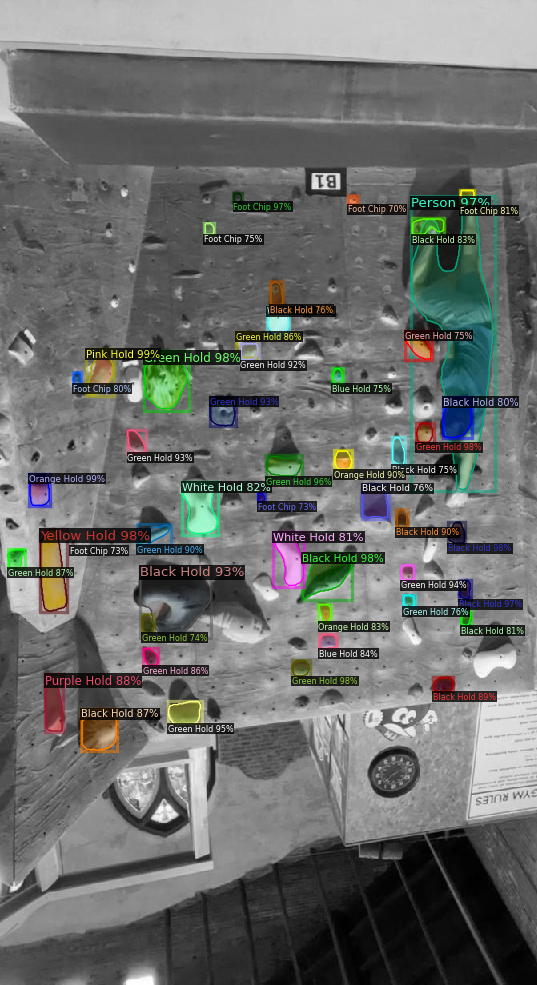

{'instances': Instances(num_instances=75, image_height=1920, image_width=1080, fields=[pred_boxes: Boxes(tensor([[ 444.8896,  338.4999,  513.3072,  400.1306],
        [ 982.7122,  793.8275, 1045.2932, 1002.6335],
        [ 128.5023,  397.1595,  194.4159,  494.5136],
        [ 308.5623,  794.3253,  373.5205,  854.9641],
        [ 695.8871,  617.6303,  983.2375, 1247.0596],
        [ 208.0660,  530.7565,  257.8267,  558.9294],
        [ 209.4060,  277.8502,  229.0903,  299.0768],
        [1033.6111,  371.7509, 1075.9746,  409.5476],
        [ 566.9695,  811.2809,  610.7068,  854.0233],
        [ 436.0902,  554.5379,  479.2193,  663.1194],
        [ 793.8340,  310.2925,  855.7622,  374.7875],
        [ 142.9677,  616.2032,  224.2444,  695.8658],
        [ 833.4501,  496.7910,  859.7367,  517.1996],
        [ 590.1299,  354.9688,  632.0721,  417.4973],
        [ 279.3605,  910.1445,  299.9781,  930.4664],
        [  52.2956,  220.6065,   94.8863,  270.2130],
        [  69.9583,    0.0000, 

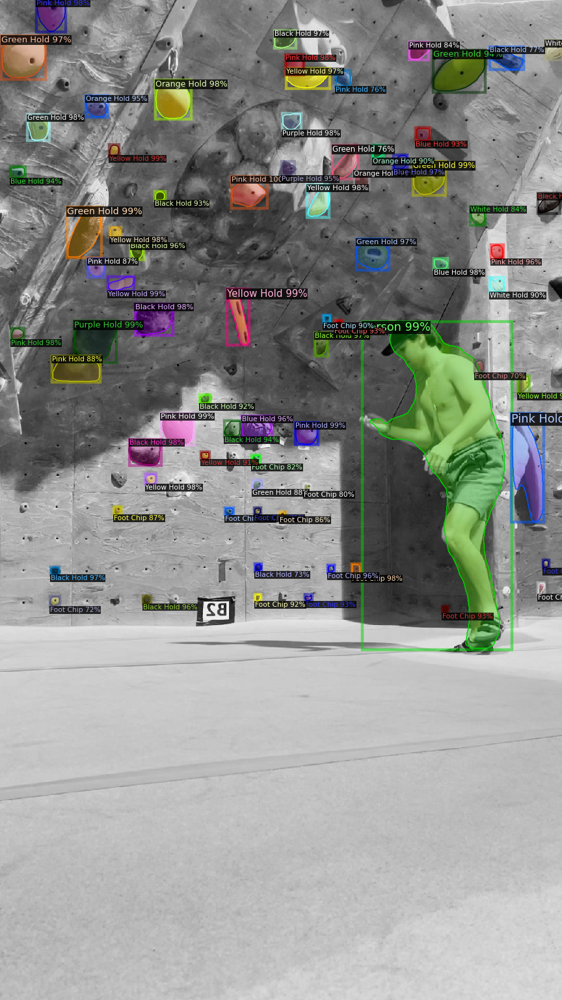

{'instances': Instances(num_instances=48, image_height=1920, image_width=1080, fields=[pred_boxes: Boxes(tensor([[ 257.5229,  813.5188,  313.8913,  877.1409],
        [ 680.9993,  733.1658,  738.9625,  780.6526],
        [ 643.0527,  539.2028,  724.1372,  605.1353],
        [ 738.2841, 1197.5046,  849.5571, 1297.5671],
        [ 558.7294,  981.1708,  673.3439, 1065.9781],
        [ 124.7488, 1063.8889,  172.9516, 1128.6302],
        [ 368.0461,    0.0000,  444.9859,  127.0979],
        [ 618.0888, 1533.6299,  758.0269, 1695.9520],
        [ 598.4889,  315.5589,  783.5928,  425.9520],
        [ 219.3448,  437.1934,  744.0955, 1214.5439],
        [  98.1459, 1711.9187,  118.2805, 1738.9824],
        [ 834.3375,  511.0790,  902.3704,  554.5197],
        [ 661.9365,  124.2940,  691.1328,  147.9942],
        [ 856.9818,  212.1513,  926.0403,  271.7099],
        [ 289.7859,  435.3233,  313.4142,  476.2990],
        [ 278.1964,  223.0677,  326.7163,  284.4958],
        [ 809.2866,  840.1819, 

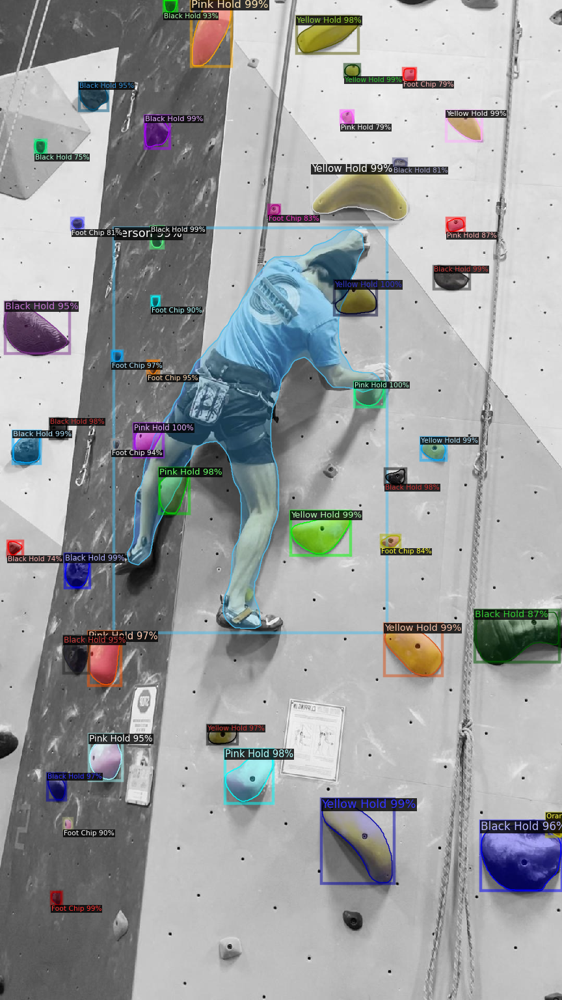

{'instances': Instances(num_instances=14, image_height=1232, image_width=672, fields=[pred_boxes: Boxes(tensor([[ 298.2415,  599.4069,  637.3348, 1001.9382],
        [ 210.5794, 1078.9185,  252.3017, 1127.2450],
        [ 586.6489,  942.3606,  626.9360,  985.9680],
        [ 617.9985, 1066.4807,  660.5191, 1106.7804],
        [ 115.8944,  451.6712,  136.2929,  472.8044],
        [ 320.9417,  738.6454,  334.6962,  751.5939],
        [ 434.5130,  643.6288,  488.9709,  662.8583],
        [  37.7846, 1068.4293,   53.7797, 1084.2108],
        [ 370.9959,  451.4962,  394.9654,  474.6478],
        [  60.9477,  703.0719,  100.5713,  741.1260],
        [ 549.1069,  458.2308,  565.2040,  476.6015],
        [ 100.3523, 1005.2643,  117.4653, 1019.1675],
        [ 451.6116, 1127.2526,  510.2392, 1151.6472],
        [ 153.9707,  988.9039,  173.2093, 1002.1888]], device='cuda:0')), scores: tensor([0.9957, 0.9949, 0.9940, 0.9927, 0.9866, 0.9862, 0.9845, 0.9833, 0.9827,
        0.9816, 0.9801, 0.9662, 

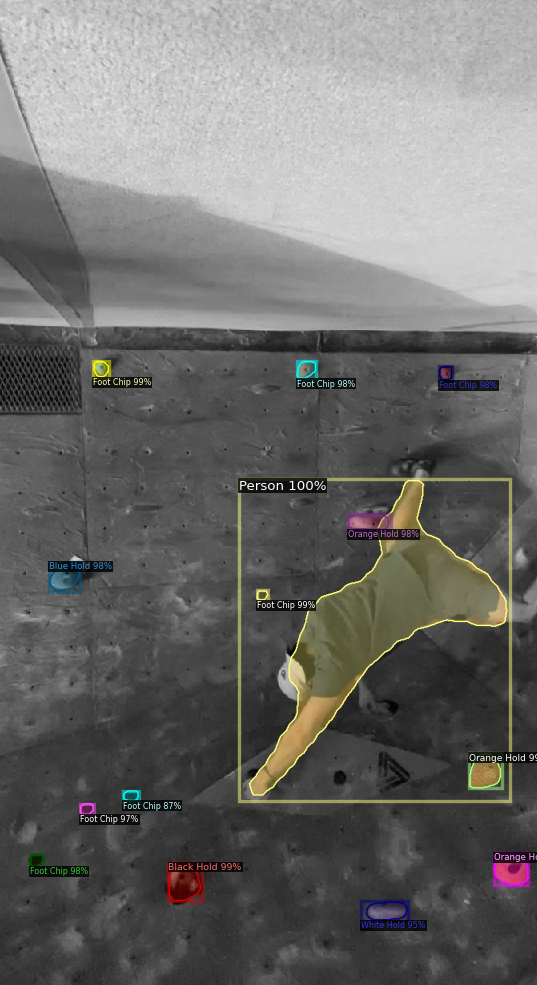

{'instances': Instances(num_instances=52, image_height=1920, image_width=1080, fields=[pred_boxes: Boxes(tensor([[ 886.5065, 1365.0027,  970.8584, 1427.0186],
        [ 257.1932,  337.8441,  357.6008,  395.3912],
        [ 624.3464,  473.3684,  745.6150,  551.1233],
        [ 667.1772,  315.6246,  708.1771,  381.5328],
        [ 118.1261,  231.5022,  220.8398,  295.0007],
        [1011.0425, 1319.8008, 1068.8479, 1435.4331],
        [ 676.0986,  734.0958, 1042.7474, 1208.2800],
        [ 284.9793,  749.7116,  324.3377,  791.0494],
        [ 448.3567,  880.2266,  493.3746,  924.8809],
        [ 195.3097, 1540.8190,  208.9646, 1554.2581],
        [ 575.2347,  535.4866,  638.8365,  595.9694],
        [ 409.8226, 1292.8087,  493.3004, 1361.5492],
        [ 550.1428,  689.8569,  632.1597,  744.2166],
        [ 326.4111,  646.4716,  385.2480,  700.5607],
        [ 285.4463,  274.2047,  368.9272,  321.6709],
        [ 503.9937,  430.4121,  594.9536,  517.4940],
        [ 693.4820,  574.2266, 

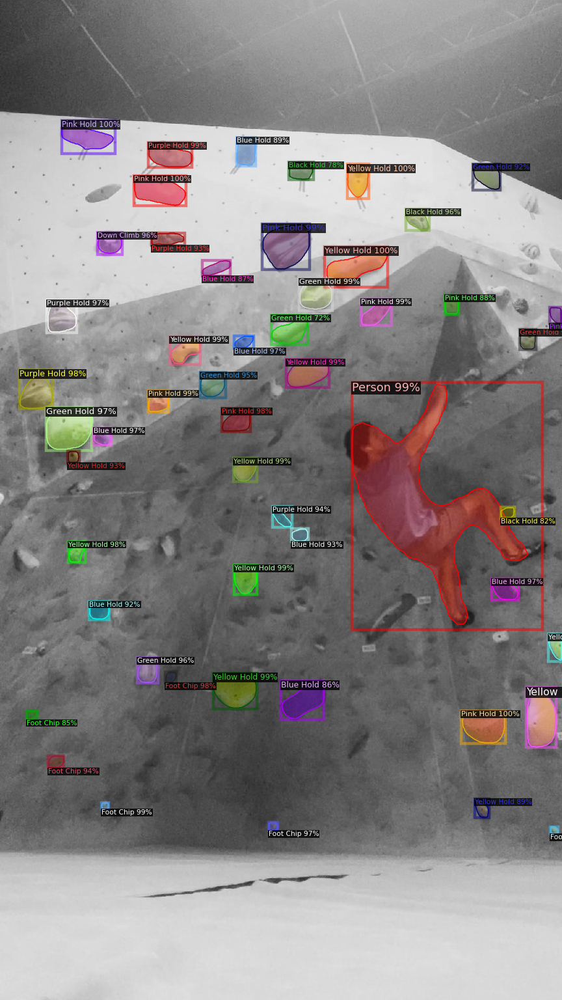

In [ ]:
dataset_valid = DatasetCatalog.get(VALID_DATA_SET_NAME)

for d in dataset_valid:
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)
    print(outputs)
    
    visualizer = Visualizer(
        img[:, :, ::-1],
        metadata=metadata, 
        scale=0.8, 
        instance_mode=ColorMode.IMAGE_BW
    )
    out = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

**Saving model below**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
from detectron2.checkpoint import DetectionCheckpointer

# Assuming that `model` is your trained model
checkpointer = DetectionCheckpointer(trainer.model, save_dir="/content")
checkpointer.save("model_final")  # This will save model_final.pth to /content directory

In [ ]:
print(os.path.exists("/content/model_final.pth"))  # Should print True if the file exists


True
